# Notebook 4: Test Exploratory Coding (First Iteration)
This notebook documents the first batch of integrated coding with the VLM. This was applied to a random sample of 95 frames from 5 videos from outside the date range of the main dataset.

**Prompt List:**
1. Prompt 3a

> You are an expert annotator of social media videos. You are provided a still image from a video. Your job is to analyze the backdrop of the image and classify it into the following five mutually exclusive setting categories. Ignore any text overlay or captions. For the provided image, select the one category that best describes its background or setting based on its definition: Graphics: Image does not contain live-action imagery (e.g., animations, CGI, black screens); Outdoor combat: Image set outdoors containing explicit signs of warfare such as visible destruction, military hardware or active combat; Outdoor non-combat: Image set outdoors WITHOUT explicit signs of warfare. This includes urban or natural landscapes without weapons or destruction; Indoor combat: Image set indoors containing explicit signs of warfare such as visible destruction, rubble, military hardware or active combat. This includes damaged interiors and confined combat settings (such as tunnels); Indoor non-combat: Image set indoors WITHOUT explicit signs of warfare. This includes studio environments and homes without weapons or destruction. Analyze the provided still and reply with one of these exact labels: “Graphics”, “Outdoor combat”, “Outdoor non‑combat”, “Indoor combat”, or “Indoor non‑combat”.

---

2. Prompt 3b (Includes motivation)

> You are an expert annotator of social media videos. You are provided a still image from a video. Your job is to analyze the backdrop of the image and classify it into the following six mutually exclusive setting categories. Ignore any text overlay or captions. For the provided image, select the one category that best describes its background or setting based on its definition: Graphics: Image is artificial or non–live‑action imagery (e.g., animations, CGI, black screens); Outdoor combat: Image set outdoors containing explicit signs of warfare such as visible destruction, military hardware or active combat; Outdoor non-combat: Image set outdoors WITHOUT explicit signs of warfare. This includes urban or natural landscapes without weapons or destruction; Indoor combat: Image set indoors containing explicit signs of warfare such as visible destruction, rubble, military hardware or active combat. This includes damaged interiors and confined combat settings (such as tunnels); Indoor non-combat: Image set indoors WITHOUT explicit signs of warfare. This includes studio environments and homes without weapons or destruction. Respond with a Python-style tuple in the format: ("classification", "motivation") - "classification" must be one of: "Graphics", "Outdoor combat", "Outdoor non-combat", "Indoor combat", or "Indoor non-combat"; "motivation" is a justification of your classification in 50 words or fewer, explaining what visual elements in the image led to your choice.

---

3. Prompt 3c (Motivation and option for "Uncertain")

> You are an expert annotator of social media videos. You are provided a still image from a video. Your job is to analyze the backdrop of the image and classify it into the following six mutually exclusive setting categories. Ignore any text overlay or captions. For the provided image, select the one category that best describes its background or setting based on its definition: Graphics: Image is artificial or non–live‑action imagery (e.g., animations, CGI, black screens); Outdoor combat: Image set outdoors containing explicit signs of warfare such as visible destruction, military hardware or active combat; Outdoor non-combat: Image set outdoors WITHOUT explicit signs of warfare. This includes urban or natural landscapes without weapons or destruction; Indoor combat: Image set indoors containing explicit signs of warfare such as visible destruction, rubble, military hardware or active combat. This includes damaged interiors and confined combat settings (such as tunnels); Indoor non-combat: Image set indoors WITHOUT explicit signs of warfare. This includes studio environments and homes without weapons or destruction. However, if you are uncertain, return 'Uncertain'.  Respond with a Python-style tuple in the format: ("classification", "motivation") - "classification" must be one of: "Graphics", "Outdoor combat", "Outdoor non-combat", "Indoor combat", "Indoor non-combat", or “Uncertain; "motivation" is a justification of your classification in 50 words or fewer, explaining what visual elements in the image led to your choice or uncertainty.


In [62]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import face_recognition
import re
import ast
import krippendorff
import networkx as nx

In [2]:
# Establish directory
frames_folder = '/Users/mikechow.sg/Documents/03a UvA/03_Thesis/idf_spokespersonship/coding_sample/01a_test_sample_1'
coding_main_vlm_path = '/Users/mikechow.sg/Documents/03a UvA/03_Thesis/idf_spokespersonship/coding_sample/01a_test_sample_1/test_sample_scenes_1.csv'
coding_m_path = '/Users/mikechow.sg/Documents/03a UvA/03_Thesis/idf_spokespersonship/coding_sample/01a_test_sample_1/test_sample_scenes_1_m.csv'
coding_c_path = '/Users/mikechow.sg/Documents/03a UvA/03_Thesis/idf_spokespersonship/coding_sample/01a_test_sample_1/test_sample_scenes_1_c.csv'

# Clean up original VLM Data
This section takes the original VLM data and parses it

In [38]:
df_coding_main = pd.read_csv(coding_main_vlm_path)
df_coding_main

,id,url,from_dataset,start_frame,start_time,start_fps,end_frame,end_time,end_fps,scene_num,num_scenes_detected,total_video_frames,total_video_duration,post_ids,setting_vlm_3a,shot_scale_vlm_01,setting_vlm_3b_tuple,setting_vlm_3c_tuple
0,7426337293369101586.mp4_scene_1,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,0,00:00:00.000,23.976,114,00:00:04.755,23.976,1,7,1170,00:00:48.799,"7,4,2,6,3,3,7,2,9,3,3,6,9,1,0,1,5,8,6",Outdoor non-combat,Medium Close Up,"(""Outdoor non-combat"", ""The setting appears to...","(""Outdoor non-combat"", ""The setting appears to..."
1,7426337293369101586.mp4_scene_2,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,114,00:00:04.755,23.976,316,00:00:13.180,23.976,2,7,1170,00:00:48.799,"7,4,2,6,3,3,7,2,9,3,3,6,9,1,0,1,5,8,6",Indoor non-combat,Close Up,"(""Indoor non-combat"", ""The setting appears to ...","(""Indoor non-combat"", ""The setting appears to ..."
2,7426337293369101586.mp4_scene_3,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,316,00:00:13.180,23.976,501,00:00:20.896,23.976,3,7,1170,00:00:48.799,"7,4,2,6,3,3,7,2,9,3,3,6,9,1,0,1,5,8,6",Outdoor non-combat,Close Up,"(""Outdoor non-combat"", ""The setting appears to...","(""Outdoor non-combat"", ""The setting appears to..."
3,7426337293369101586.mp4_scene_4,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,501,00:00:20.896,23.976,669,00:00:27.903,23.976,4,7,1170,00:00:48.799,"7,4,2,6,3,3,7,2,9,3,3,6,9,1,0,1,5,8,6",Indoor non-combat,Medium Close Up,"(""Indoor non-combat"", ""The setting appears to ...","(""Indoor non-combat"", ""The setting appears to ..."
4,7426337293369101586.mp4_scene_5,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,669,00:00:27.903,23.976,887,00:00:36.995,23.976,5,7,1170,00:00:48.799,"7,4,2,6,3,3,7,2,9,3,3,6,9,1,0,1,5,8,6",Outdoor non-combat,Medium Close Up,"(""Outdoor non-combat"", ""The setting appears to...","(""Indoor non-combat"", ""The setting appears to ..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
90,7425245804295654663.mp4_scene_10,7425245804295654663,dd01ff7a2a7ed42db656b1c7dbede342,1926,00:01:04.200,30.000,2137,00:01:11.233,30.000,10,14,2837,00:01:34.567,"7,4,2,5,2,4,5,8,0,4,2,9,5,6,5,4,6,6,3",Outdoor non-combat,Close Up,"(""Outdoor non-combat"", ""The image shows an ind...","(""Outdoor non-combat"", ""The setting appears to..."
91,7425245804295654663.mp4_scene_11,7425245804295654663,dd01ff7a2a7ed42db656b1c7dbede342,2137,00:01:11.233,30.000,2290,00:01:16.333,30.000,11,14,2837,00:01:34.567,"7,4,2,5,2,4,5,8,0,4,2,9,5,6,5,4,6,6,3",Outdoor non-combat,Close Up,"(""Outdoor non-combat"", ""The backdrop shows an ...","(""Outdoor non-combat"", ""The backdrop shows an ..."
92,7425245804295654663.mp4_scene_12,7425245804295654663,dd01ff7a2a7ed42db656b1c7dbede342,2290,00:01:16.333,30.000,2475,00:01:22.500,30.000,12,14,2837,00:01:34.567,"7,4,2,5,2,4,5,8,0,4,2,9,5,6,5,4,6,6,3",Indoor combat,Medium Full Shot,"(""Indoor combat"", ""The image shows military eq...","(""Indoor combat"", ""The image shows military eq..."
93,7425245804295654663.mp4_scene_13,7425245804295654663,dd01ff7a2a7ed42db656b1c7dbede342,2475,00:01:22.500,30.000,2561,00:01:25.367,30.000,13,14,2837,00:01:34.567,"7,4,2,5,2,4,5,8,0,4,2,9,5,6,5,4,6,6,3",Outdoor non-combat,Close Up,"(""Outdoor non-combat"", ""The background shows a...","(""Outdoor non-combat"", ""The background appears..."


In [35]:
# Function for safe eval of tuples
def safe_eval(value):
    try:
        return ast.literal_eval(value)
    except (ValueError, SyntaxError):
        print(f"Error parsing '{value}'")
        return None  # Return None or any fallback value for invalid strings


In [39]:
# Convert column into tuple
df_coding_main['setting_vlm_3b_tuple'] = df_coding_main['setting_vlm_3b_tuple'].apply(safe_eval)

In [40]:
# Split tuples into results and motivation
for i, scene in df_coding_main.iterrows():
    tuple_value = scene['setting_vlm_3b_tuple']
    if tuple_value is not None:
        result = tuple_value[0]
        motivation = tuple_value[1]
        df_coding_main.loc[i, 'setting_vlm_3b'] = result
        df_coding_main.loc[i, 'setting_vlm_3b_motivation'] = motivation
        print(f"Classification result: {result} Motivation: {motivation}")
        print()


Classification result: Outdoor non-combat Motivation: The setting appears to be an outdoor area with grass and structures that resemble a park or recreational space, without any visible signs of warfare such as destruction or military hardware.

Classification result: Indoor non-combat Motivation: The setting appears to be indoors with no signs of warfare such as destruction or military hardware visible. The person is engaged in a craft activity at a table.

Classification result: Outdoor non-combat Motivation: The setting appears to be an outdoor area with a makeshift structure and decorations, suggesting a casual environment without signs of warfare such as destruction or military hardware.

Classification result: Indoor non-combat Motivation: The setting appears to be inside a tent with no visible signs of warfare such as destruction or military hardware, and the person is dressed in civilian clothing rather than combat gear.

Classification result: Outdoor non-combat Motivation: Th

In [41]:
# Repeat for 03
df_coding_main['setting_vlm_3c_tuple'] = df_coding_main['setting_vlm_3c_tuple'].apply(safe_eval)

# Split tuples into results and motivation
for i, scene in df_coding_main.iterrows():
    tuple_value = scene['setting_vlm_3c_tuple']
    if tuple_value is not None:
        result = tuple_value[0]
        motivation = tuple_value[1]
        df_coding_main.loc[i, 'setting_vlm_3c'] = result
        df_coding_main.loc[i, 'setting_vlm_3c_motivation'] = motivation
        print(f"Classification result: {result} Motivation: {motivation}")
        print()

Classification result: Outdoor non-combat Motivation: The setting appears to be an outdoor area with grass and some structures that resemble party decorations, indicating it's not a combat zone but rather a social gathering space.

Classification result: Indoor non-combat Motivation: The setting appears to be indoors with no signs of warfare such as destruction or military hardware visible. The person is engaged in a craft activity on a table.

Classification result: Outdoor non-combat Motivation: The setting appears to be outdoors with a wooden structure and string decorations, suggesting a casual environment without signs of warfare such as destruction or military hardware.

Classification result: Indoor non-combat Motivation: The setting appears to be indoors with no visible signs of warfare such as destruction or military hardware. The environment looks like a temporary setup possibly for an educational or informational purpose.

Classification result: Indoor non-combat Motivation:

In [42]:
df_coding_main

,id,url,from_dataset,start_frame,start_time,start_fps,end_frame,end_time,end_fps,scene_num,...,total_video_duration,post_ids,setting_vlm_3a,shot_scale_vlm_01,setting_vlm_3b_tuple,setting_vlm_3c_tuple,setting_vlm_3b,setting_vlm_3b_motivation,setting_vlm_3c,setting_vlm_3c_motivation
0,7426337293369101586.mp4_scene_1,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,0,00:00:00.000,23.976,114,00:00:04.755,23.976,1,...,00:00:48.799,"7,4,2,6,3,3,7,2,9,3,3,6,9,1,0,1,5,8,6",Outdoor non-combat,Medium Close Up,"(Outdoor non-combat, The setting appears to be...","(Outdoor non-combat, The setting appears to be...",Outdoor non-combat,The setting appears to be an outdoor area with...,Outdoor non-combat,The setting appears to be an outdoor area with...
1,7426337293369101586.mp4_scene_2,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,114,00:00:04.755,23.976,316,00:00:13.180,23.976,2,...,00:00:48.799,"7,4,2,6,3,3,7,2,9,3,3,6,9,1,0,1,5,8,6",Indoor non-combat,Close Up,"(Indoor non-combat, The setting appears to be ...","(Indoor non-combat, The setting appears to be ...",Indoor non-combat,The setting appears to be indoors with no sign...,Indoor non-combat,The setting appears to be indoors with no sign...
2,7426337293369101586.mp4_scene_3,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,316,00:00:13.180,23.976,501,00:00:20.896,23.976,3,...,00:00:48.799,"7,4,2,6,3,3,7,2,9,3,3,6,9,1,0,1,5,8,6",Outdoor non-combat,Close Up,"(Outdoor non-combat, The setting appears to be...","(Outdoor non-combat, The setting appears to be...",Outdoor non-combat,The setting appears to be an outdoor area with...,Outdoor non-combat,The setting appears to be outdoors with a wood...
3,7426337293369101586.mp4_scene_4,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,501,00:00:20.896,23.976,669,00:00:27.903,23.976,4,...,00:00:48.799,"7,4,2,6,3,3,7,2,9,3,3,6,9,1,0,1,5,8,6",Indoor non-combat,Medium Close Up,"(Indoor non-combat, The setting appears to be ...","(Indoor non-combat, The setting appears to be ...",Indoor non-combat,The setting appears to be inside a tent with n...,Indoor non-combat,The setting appears to be indoors with no visi...
4,7426337293369101586.mp4_scene_5,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,669,00:00:27.903,23.976,887,00:00:36.995,23.976,5,...,00:00:48.799,"7,4,2,6,3,3,7,2,9,3,3,6,9,1,0,1,5,8,6",Outdoor non-combat,Medium Close Up,"(Outdoor non-combat, The setting appears to be...","(Indoor non-combat, The setting appears to be ...",Outdoor non-combat,The setting appears to be an outdoor area with...,Indoor non-combat,The setting appears to be indoors with no sign...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
90,7425245804295654663.mp4_scene_10,7425245804295654663,dd01ff7a2a7ed42db656b1c7dbede342,1926,00:01:04.200,30.000,2137,00:01:11.233,30.000,10,...,00:01:34.567,"7,4,2,5,2,4,5,8,0,4,2,9,5,6,5,4,6,6,3",Outdoor non-combat,Close Up,"(Outdoor non-combat, The image shows an indivi...","(Outdoor non-combat, The setting appears to be...",Outdoor non-combat,The image shows an individual wearing military...,Outdoor non-combat,The setting appears to be outdoors with trees ...
91,7425245804295654663.mp4_scene_11,7425245804295654663,dd01ff7a2a7ed42db656b1c7dbede342,2137,00:01:11.233,30.000,2290,00:01:16.333,30.000,11,...,00:01:34.567,"7,4,2,5,2,4,5,8,0,4,2,9,5,6,5,4,6,6,3",Outdoor non-combat,Close Up,"(Outdoor non-combat, The backdrop shows an out...","(Outdoor non-combat, The backdrop shows an out...",Outdoor non-combat,The backdrop shows an outdoor setting with vis...,Outdoor non-combat,The backdrop shows an outdoor setting with vis...
92,7425245804295654663.mp4_scene_12,7425245804295654663,dd01ff7a2a7ed42db656b1c7dbede342,2290,00:01:16.333,30.000,2475,00:01:22.500,30.000,12,...,00:01:34.567,"7,4,2,5,2,4,5,8,0,4,2,9,5,6,5,4,6,6,3",Indoor combat,Medium Full Shot,"(Indoor combat, The image shows military equip...","(Indoor combat, The image shows military equip...",Indoor combat,The image sh

In [43]:
# Coerce columns formatting
df_coding_main['setting_vlm_3a'] = df_coding_main['setting_vlm_3a'].str.lower().str.capitalize()
df_coding_main['setting_vlm_3b'] = df_coding_main['setting_vlm_3b'].str.lower().str.capitalize()
df_coding_main['setting_vlm_3c'] = df_coding_main['setting_vlm_3c'].str.lower().str.capitalize()

df_coding_main

,id,url,from_dataset,start_frame,start_time,start_fps,end_frame,end_time,end_fps,scene_num,...,total_video_duration,post_ids,setting_vlm_3a,shot_scale_vlm_01,setting_vlm_3b_tuple,setting_vlm_3c_tuple,setting_vlm_3b,setting_vlm_3b_motivation,setting_vlm_3c,setting_vlm_3c_motivation
0,7426337293369101586.mp4_scene_1,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,0,00:00:00.000,23.976,114,00:00:04.755,23.976,1,...,00:00:48.799,"7,4,2,6,3,3,7,2,9,3,3,6,9,1,0,1,5,8,6",Outdoor non-combat,Medium Close Up,"(Outdoor non-combat, The setting appears to be...","(Outdoor non-combat, The setting appears to be...",Outdoor non-combat,The setting appears to be an outdoor area with...,Outdoor non-combat,The setting appears to be an outdoor area with...
1,7426337293369101586.mp4_scene_2,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,114,00:00:04.755,23.976,316,00:00:13.180,23.976,2,...,00:00:48.799,"7,4,2,6,3,3,7,2,9,3,3,6,9,1,0,1,5,8,6",Indoor non-combat,Close Up,"(Indoor non-combat, The setting appears to be ...","(Indoor non-combat, The setting appears to be ...",Indoor non-combat,The setting appears to be indoors with no sign...,Indoor non-combat,The setting appears to be indoors with no sign...
2,7426337293369101586.mp4_scene_3,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,316,00:00:13.180,23.976,501,00:00:20.896,23.976,3,...,00:00:48.799,"7,4,2,6,3,3,7,2,9,3,3,6,9,1,0,1,5,8,6",Outdoor non-combat,Close Up,"(Outdoor non-combat, The setting appears to be...","(Outdoor non-combat, The setting appears to be...",Outdoor non-combat,The setting appears to be an outdoor area with...,Outdoor non-combat,The setting appears to be outdoors with a wood...
3,7426337293369101586.mp4_scene_4,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,501,00:00:20.896,23.976,669,00:00:27.903,23.976,4,...,00:00:48.799,"7,4,2,6,3,3,7,2,9,3,3,6,9,1,0,1,5,8,6",Indoor non-combat,Medium Close Up,"(Indoor non-combat, The setting appears to be ...","(Indoor non-combat, The setting appears to be ...",Indoor non-combat,The setting appears to be inside a tent with n...,Indoor non-combat,The setting appears to be indoors with no visi...
4,7426337293369101586.mp4_scene_5,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,669,00:00:27.903,23.976,887,00:00:36.995,23.976,5,...,00:00:48.799,"7,4,2,6,3,3,7,2,9,3,3,6,9,1,0,1,5,8,6",Outdoor non-combat,Medium Close Up,"(Outdoor non-combat, The setting appears to be...","(Indoor non-combat, The setting appears to be ...",Outdoor non-combat,The setting appears to be an outdoor area with...,Indoor non-combat,The setting appears to be indoors with no sign...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
90,7425245804295654663.mp4_scene_10,7425245804295654663,dd01ff7a2a7ed42db656b1c7dbede342,1926,00:01:04.200,30.000,2137,00:01:11.233,30.000,10,...,00:01:34.567,"7,4,2,5,2,4,5,8,0,4,2,9,5,6,5,4,6,6,3",Outdoor non-combat,Close Up,"(Outdoor non-combat, The image shows an indivi...","(Outdoor non-combat, The setting appears to be...",Outdoor non-combat,The image shows an individual wearing military...,Outdoor non-combat,The setting appears to be outdoors with trees ...
91,7425245804295654663.mp4_scene_11,7425245804295654663,dd01ff7a2a7ed42db656b1c7dbede342,2137,00:01:11.233,30.000,2290,00:01:16.333,30.000,11,...,00:01:34.567,"7,4,2,5,2,4,5,8,0,4,2,9,5,6,5,4,6,6,3",Outdoor non-combat,Close Up,"(Outdoor non-combat, The backdrop shows an out...","(Outdoor non-combat, The backdrop shows an out...",Outdoor non-combat,The backdrop shows an outdoor setting with vis...,Outdoor non-combat,The backdrop shows an outdoor setting with vis...
92,7425245804295654663.mp4_scene_12,7425245804295654663,dd01ff7a2a7ed42db656b1c7dbede342,2290,00:01:16.333,30.000,2475,00:01:22.500,30.000,12,...,00:01:34.567,"7,4,2,5,2,4,5,8,0,4,2,9,5,6,5,4,6,6,3",Indoor combat,Medium Full Shot,"(Indoor combat, The image shows military equip...","(Indoor combat, The image shows military equip...",Indoor combat,The image sh

# Bring in manually coded sheets
`df_coding_m` is the primary coder whereas `df_coding_c` is the secondary coder.

In [44]:
df_coding_m = pd.read_csv(coding_m_path)
df_coding_c = pd.read_csv(coding_c_path)

In [45]:
df_coding = pd.merge(df_coding_main, df_coding_m, how='left')
df_coding

,id,url,from_dataset,start_frame,start_time,start_fps,end_frame,end_time,end_fps,scene_num,...,shot_scale_vlm_01,setting_vlm_3b_tuple,setting_vlm_3c_tuple,setting_vlm_3b,setting_vlm_3b_motivation,setting_vlm_3c,setting_vlm_3c_motivation,spox_gender_m,shot_scale_m,setting_m
0,7426337293369101586.mp4_scene_1,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,0,00:00:00.000,23.976,114,00:00:04.755,23.976,1,...,Medium Close Up,"(Outdoor non-combat, The setting appears to be...","(Outdoor non-combat, The setting appears to be...",Outdoor non-combat,The setting appears to be an outdoor area with...,Outdoor non-combat,The setting appears to be an outdoor area with...,F,Medium shot,Outdoor non-combat
1,7426337293369101586.mp4_scene_2,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,114,00:00:04.755,23.976,316,00:00:13.180,23.976,2,...,Close Up,"(Indoor non-combat, The setting appears to be ...","(Indoor non-combat, The setting appears to be ...",Indoor non-combat,The setting appears to be indoors with no sign...,Indoor non-combat,The setting appears to be indoors with no sign...,F,Medium close up,Indoor non-combat
2,7426337293369101586.mp4_scene_3,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,316,00:00:13.180,23.976,501,00:00:20.896,23.976,3,...,Close Up,"(Outdoor non-combat, The setting appears to be...","(Outdoor non-combat, The setting appears to be...",Outdoor non-combat,The setting appears to be an outdoor area with...,Outdoor non-combat,The setting appears to be outdoors with a wood...,F,Medium close up,Indoor non-combat
3,7426337293369101586.mp4_scene_4,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,501,00:00:20.896,23.976,669,00:00:27.903,23.976,4,...,Medium Close Up,"(Indoor non-combat, The setting appears to be ...","(Indoor non-combat, The setting appears to be ...",Indoor non-combat,The setting appears to be inside a tent with n...,Indoor non-combat,The setting appears to be indoors with no visi...,F,Medium shot,Indoor non-combat
4,7426337293369101586.mp4_scene_5,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,669,00:00:27.903,23.976,887,00:00:36.995,23.976,5,...,Medium Close Up,"(Outdoor non-combat, The setting appears to be...","(Indoor non-combat, The setting appears to be ...",Outdoor non-combat,The setting appears to be an outdoor area with...,Indoor non-combat,The setting appears to be indoors with no sign...,F,Medium full shot,Indoor non-combat
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
90,7425245804295654663.mp4_scene_10,7425245804295654663,dd01ff7a2a7ed42db656b1c7dbede342,1926,00:01:04.200,30.000,2137,00:01:11.233,30.000,10,...,Close Up,"(Outdoor non-combat, The image shows an indivi...","(Outdoor non-combat, The setting appears to be...",Outdoor non-combat,The image shows an individual wearing military...,Outdoor non-combat,The setting appears to be outdoors with trees ...,F,Selfie,Outdoor combat
91,7425245804295654663.mp4_scene_11,7425245804295654663,dd01ff7a2a7ed42db656b1c7dbede342,2137,00:01:11.233,30.000,2290,00:01:16.333,30.000,11,...,Close Up,"(Outdoor non-combat, The backdrop shows an out...","(Outdoor non-combat, The backdrop shows an out...",Outdoor non-combat,The backdrop shows an outdoor setting with vis...,Outdoor non-combat,The backdrop shows an outdoor setting with vis...,F,Selfie,Outdoor combat
92,7425245804295654663.mp4_scene_12,7425245804295654663,dd01ff7a2a7ed42db656b1c7dbede342,2290,00:01:16.333,30.000,2475,00:01:22.500,30.000,12,...,Medium Full Shot,"(Indoor combat, The image shows military equip...","(Indoor combat, The image shows military equip...",Indoor combat,The image shows military equipment and destruc...,Indoor combat,The image shows military equipment and destruc...,no_spox,Empty,Indoor combat
93,7425245804295654663.mp4_scene_13,7425245804295654663,dd01ff7a2a7ed42db656b1c7dbede342,2475,00:01:22.500,30.000,2561,00:01:25.367,30.000,13,...,Close Up,"(Outdoor non-combat, The background shows an o...","(Outdoor non-comb

In [46]:
df_coding = pd.merge(df_coding, df_coding_c, how='left')
df_coding

,id,url,from_dataset,start_frame,start_time,start_fps,end_frame,end_time,end_fps,scene_num,...,setting_vlm_3b,setting_vlm_3b_motivation,setting_vlm_3c,setting_vlm_3c_motivation,spox_gender_m,shot_scale_m,setting_m,spox_gender_c,shot_scale_c,setting_c
0,7426337293369101586.mp4_scene_1,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,0,00:00:00.000,23.976,114,00:00:04.755,23.976,1,...,Outdoor non-combat,The setting appears to be an outdoor area with...,Outdoor non-combat,The setting appears to be an outdoor area with...,F,Medium shot,Outdoor non-combat,F,Medium shot,Outdoor non-combat
1,7426337293369101586.mp4_scene_2,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,114,00:00:04.755,23.976,316,00:00:13.180,23.976,2,...,Indoor non-combat,The setting appears to be indoors with no sign...,Indoor non-combat,The setting appears to be indoors with no sign...,F,Medium close up,Indoor non-combat,F,Medium close up,Outdoor non-combat
2,7426337293369101586.mp4_scene_3,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,316,00:00:13.180,23.976,501,00:00:20.896,23.976,3,...,Outdoor non-combat,The setting appears to be an outdoor area with...,Outdoor non-combat,The setting appears to be outdoors with a wood...,F,Medium close up,Indoor non-combat,F,Medium close up,Outdoor non-combat
3,7426337293369101586.mp4_scene_4,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,501,00:00:20.896,23.976,669,00:00:27.903,23.976,4,...,Indoor non-combat,The setting appears to be inside a tent with n...,Indoor non-combat,The setting appears to be indoors with no visi...,F,Medium shot,Indoor non-combat,F,Medium shot,Outdoor non-combat
4,7426337293369101586.mp4_scene_5,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,669,00:00:27.903,23.976,887,00:00:36.995,23.976,5,...,Outdoor non-combat,The setting appears to be an outdoor area with...,Indoor non-combat,The setting appears to be indoors with no sign...,F,Medium full shot,Indoor non-combat,F,Medium shot,Outdoor non-combat
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
90,7425245804295654663.mp4_scene_10,7425245804295654663,dd01ff7a2a7ed42db656b1c7dbede342,1926,00:01:04.200,30.000,2137,00:01:11.233,30.000,10,...,Outdoor non-combat,The image shows an individual wearing military...,Outdoor non-combat,The setting appears to be outdoors with trees ...,F,Selfie,Outdoor combat,F,Selfie,Outdoor non-combat
91,7425245804295654663.mp4_scene_11,7425245804295654663,dd01ff7a2a7ed42db656b1c7dbede342,2137,00:01:11.233,30.000,2290,00:01:16.333,30.000,11,...,Outdoor non-combat,The backdrop shows an outdoor setting with vis...,Outdoor non-combat,The backdrop shows an outdoor setting with vis...,F,Selfie,Outdoor combat,F,Selfie,Outdoor non-combat
92,7425245804295654663.mp4_scene_12,7425245804295654663,dd01ff7a2a7ed42db656b1c7dbede342,2290,00:01:16.333,30.000,2475,00:01:22.500,30.000,12,...,Indoor combat,The image shows military equipment and destruc...,Indoor combat,The image shows military equipment and destruc...,no_spox,Empty,Indoor combat,no_spox,Empty,Indoor combat
93,7425245804295654663.mp4_scene_13,7425245804295654663,dd01ff7a2a7ed42db656b1c7dbede342,2475,00:01:22.500,30.000,2561,00:01:25.367,30.000,13,...,Outdoor non-combat,The background shows an outdoor setting with n...,Outdoor non-combat,The background appears to be an outdoor settin...,F,Selfie,Outdoor combat,F,Selfie,Outdoor non-combat


In [47]:
# Compare distributions quickly
print(df_coding['setting_m'].value_counts())
print(df_coding['setting_c'].value_counts())
print(df_coding['setting_vlm_3a'].value_counts())
print(df_coding['setting_vlm_3b'].value_counts())
print(df_coding['setting_vlm_3c'].value_counts())


setting_m
Indoor combat         36
Outdoor combat        28
Outdoor non-combat    25
Indoor non-combat      6
Name: count, dtype: int64
setting_c
Outdoor non-combat    40
Indoor combat         34
Outdoor combat        20
Indoor non-combat      1
Name: count, dtype: int64
setting_vlm_3a
Outdoor non-combat    48
Indoor combat         24
Indoor non-combat     17
Outdoor combat         6
Name: count, dtype: int64
setting_vlm_3b
Outdoor non-combat    45
Indoor combat         27
Indoor non-combat     11
Outdoor combat        10
Graphics               2
Name: count, dtype: int64
setting_vlm_3c
Outdoor non-combat    44
Indoor combat         27
Indoor non-combat     11
Outdoor combat         9
Graphics               3
Uncertain              1
Name: count, dtype: int64


In [48]:
df_coding.to_csv('/Users/mikechow.sg/Documents/03a UvA/03_Thesis/idf_spokespersonship/coding_sample/01a_test_sample_1/test_sample_scenes_1_merged.csv', index=False)

In [3]:
df_coding = pd.read_csv('/Users/mikechow.sg/Documents/03a UvA/03_Thesis/idf_spokespersonship/coding_sample/01a_test_sample_1/test_sample_scenes_1_merged.csv')

# Analysis of results
Here we will review the results of the coding, by calculating the intercoder reliability as well as manually reviewing the motivations provided by the VLM.

In [50]:
def preprocess_for_alpha(df):
    """
    Preprocess DataFrame columns to encode categorical values as numeric.
    This dynamically handles categorical data and missing values (NaN).
    """
    df_processed = df.copy()

    # Use pandas' factorization to encode categories into integer values
    for column in df_processed.columns:
        df_processed[column], _ = pd.factorize(df_processed[column], use_na_sentinel=True)
        # Replace factorized -1 (used for NaN) with np.nan for proper handling
        # df_processed[column] = df_processed[column].replace(-1, np.nan)

    return df_processed


def calc_alpha(df, level_of_measurement='nominal'):

    # Preprocess the data
    # df_numeric = preprocess_for_alpha(df)

    ratings = df.to_numpy().T

    alpha = krippendorff.alpha(ratings, level_of_measurement=level_of_measurement)
    # print(f"Krippendorff's Alpha: {alpha}")
    return alpha


In [54]:
# Manually refactor code categories
setting_refactor = {'Graphics' : 1,
                    'Indoor combat': 2,
                    'Indoor non-combat': 3,
                    'Outdoor combat': 4,
                    'Outdoor non-combat': 5,
                    'Uncertain': np.nan}

In [52]:
# Check Intercoder reliability
# Define the combinations of columns to be compared
df_intercoder_alpha = pd.DataFrame([
    {'column_1':'setting_m','column_2':'setting_c','type':'setting'},

    {'column_1':'setting_m','column_2':'setting_vlm_3a','type':'setting'},
    {'column_1':'setting_c','column_2':'setting_vlm_3a','type':'setting'},

    {'column_1':'setting_m','column_2':'setting_vlm_3b','type':'setting'},
    {'column_1':'setting_c','column_2':'setting_vlm_3b','type':'setting'},

    {'column_1':'setting_m','column_2':'setting_vlm_3c','type':'setting'},
    {'column_1':'setting_c','column_2':'setting_vlm_3c','type':'setting'},

    {'column_1':'setting_vlm_3a','column_2':'setting_vlm_3b','type':'setting'},
    {'column_1':'setting_vlm_3a','column_2':'setting_vlm_3c','type':'setting'},
    {'column_1':'setting_vlm_3b','column_2':'setting_vlm_3c','type':'setting'},

])


In [55]:
for i, row in df_intercoder_alpha.iterrows():
    column_1 = row['column_1']
    column_2 = row['column_2']
    coding_type = row['type']
    if coding_type == 'setting':
        refactor_dict = setting_refactor

    df_intercoder = df_coding[[column_1, column_2]].copy()
    df_intercoder[column_1] =  df_intercoder[column_1].map(refactor_dict)
    df_intercoder[column_2] =  df_intercoder[column_2].map(refactor_dict)


    df_intercoder = df_intercoder.replace(-1, np.nan)

    # print(df_intercoder)

    df_intercoder_alpha.loc[i, 'intercoder_alpha'] = calc_alpha(df_intercoder[[column_1, column_2]])



In [56]:
df_intercoder_alpha

,column_1,column_2,type,intercoder_alpha
0,setting_m,setting_c,setting,0.708310
1,setting_m,setting_vlm_3a,setting,0.421565
2,setting_c,setting_vlm_3a,setting,0.527342
3,setting_m,setting_vlm_3b,setting,0.555189
4,setting_c,setting_vlm_3b,setting,0.655024
5,setting_m,setting_vlm_3c,setting,0.537572
6,setting_c,setting_vlm_3c,setting,0.651799
7,setting_vlm_3a,setting_vlm_3b,setting,0.825338
8,setting_vlm_3a,setting_vlm_3c,setting,0.807514
9,setting_vlm_3b,setting_vlm_3c,setting,0.905236


Reviewing this, we can see that the VLM is generally stable within their annotations. It is particularly strong with and without the "Uncertain" option. This is a good sign.

Between the human coders, the agreement is acceptable but could be better. The agreements with the VLM were less than the minimum acceptable threshold of 0.667. Interestingly, the VLM agreed with the secondary coder moreso than myself.

In [60]:
# Filter for visualization to avoid clutter
df_intercoder_alpha_select = df_intercoder_alpha.loc[[0,3,4]]
df_intercoder_alpha_select

,column_1,column_2,type,intercoder_alpha
0,setting_m,setting_c,setting,0.708310
3,setting_m,setting_vlm_3b,setting,0.555189
4,setting_c,setting_vlm_3b,setting,0.655024


In [61]:
print(df_intercoder_alpha_select)

    column_1        column_2     type  intercoder_alpha
0  setting_m       setting_c  setting          0.708310
3  setting_m  setting_vlm_3b  setting          0.555189
4  setting_c  setting_vlm_3b  setting          0.655024


In [71]:
# Visualize as network diagram
def viz_agreement_network(df, output_path=None):

    # Initialize the graph
    G = nx.Graph()

    # List of nodes
    nodes = list(set(df['column_1'].tolist() + df['column_2'].tolist()))
    G.add_nodes_from(nodes)

    # Add edges with weights
    for i, row in df.iterrows():
        G.add_edge(row['column_1'], row['column_2'], weight=row['intercoder_alpha'])

    # Plot the graph
    plt.figure(figsize=(10,10))
    pos = nx.spring_layout(G)  # Layout algorithm for positions
    edges = G.edges(data=True)

    # Prepare edge widths based on intercoder_alpha
    widths = [d['weight'] * 30 for (u, v, d) in edges]  # multiplied for visibility

    nx.draw(G, pos, with_labels=True, node_size=2000, node_color='skyblue',
            width=widths, edge_color='blue', alpha=0.6,
            font_size=10, font_weight='bold')

    # # Add edge labels to show scores
    # edge_labels = {(u, v): f"{d['weight']:.2f}" for u, v, d in edges}
    # nx.draw_network_labels(G, pos, edge_labels=edge_labels, font_color='red')

    plt.title("Intercoder Agreement Network")
    plt.axis('off')
    if output_path is not None:
        plt.savefig(output_path)
    plt.show()

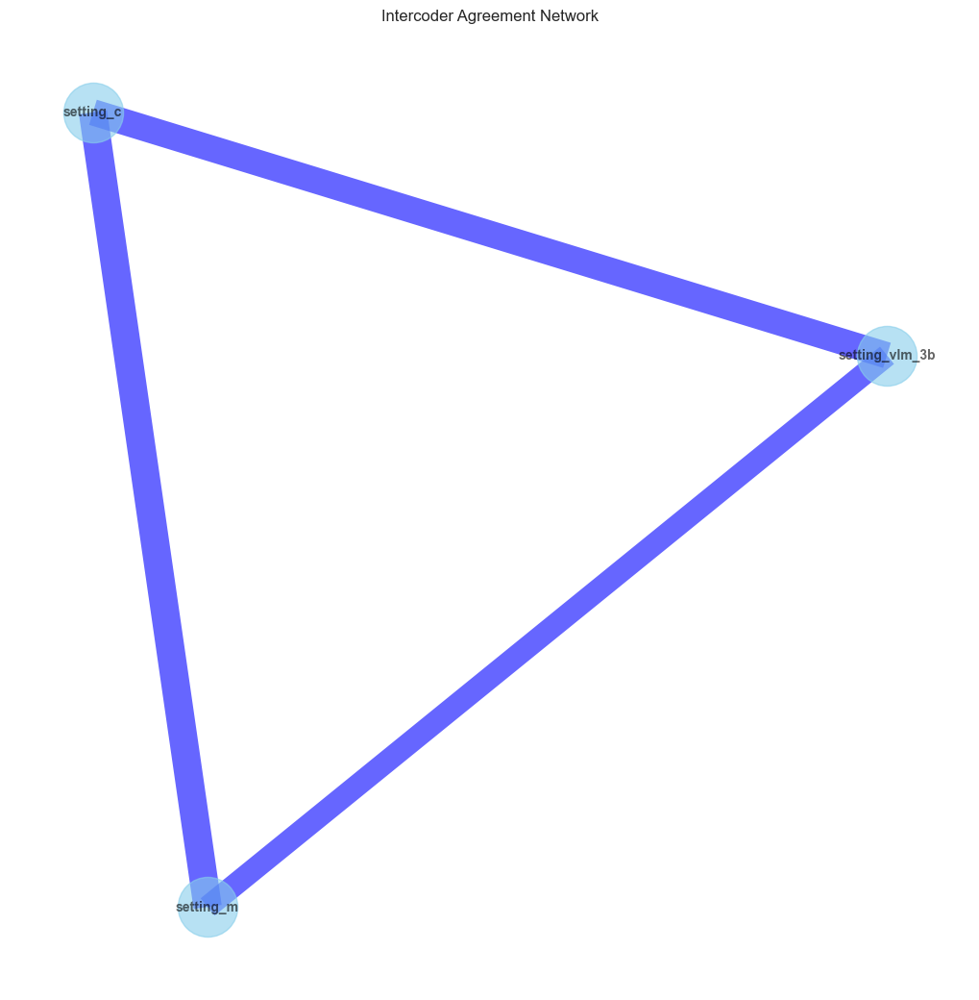

In [72]:
viz_agreement_network(df_intercoder_alpha_select, '/Users/mikechow.sg/Documents/03a UvA/03_Thesis/idf_spokespersonship/coding_sample/01a_test_sample_1/setting_agreement_network.svg')

Because they are so near each other, they look visually identical with one another unfortunately.

# Visualizing results for review
We can now visualize the results and motivations to review.
In the interest of reducing clutter, only prompt 3b and 3c were reviewed.

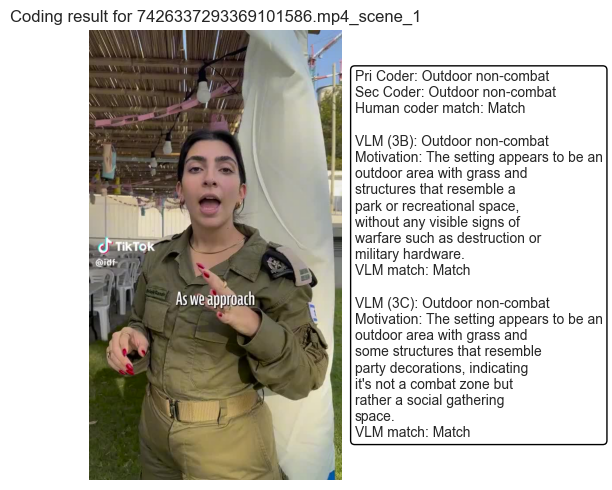

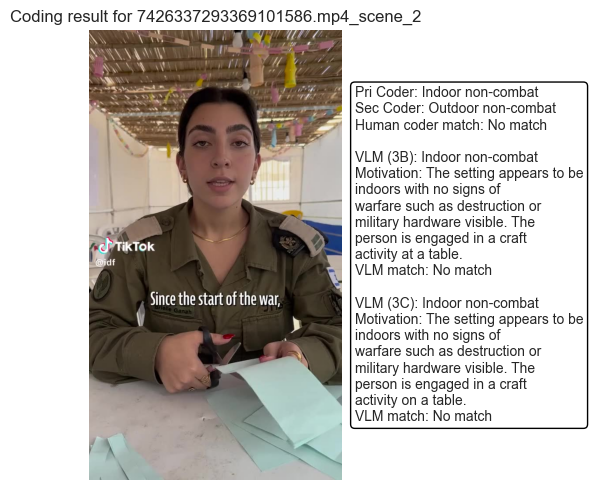

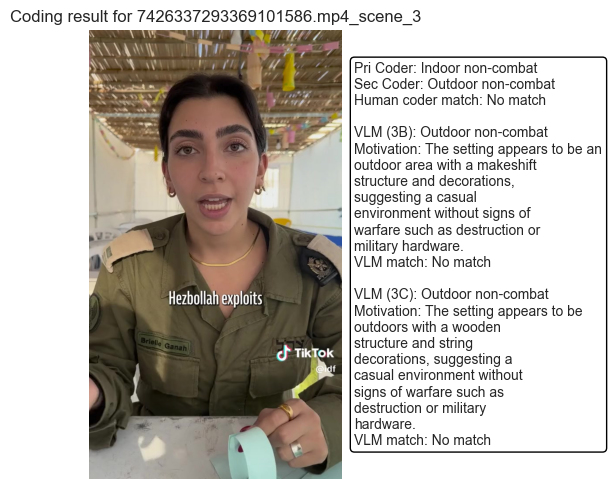

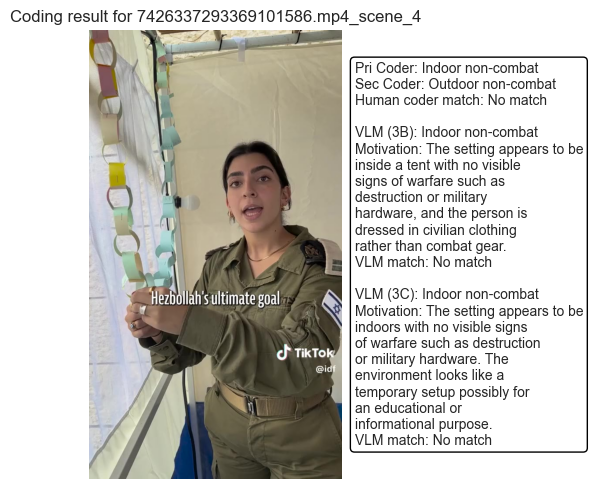

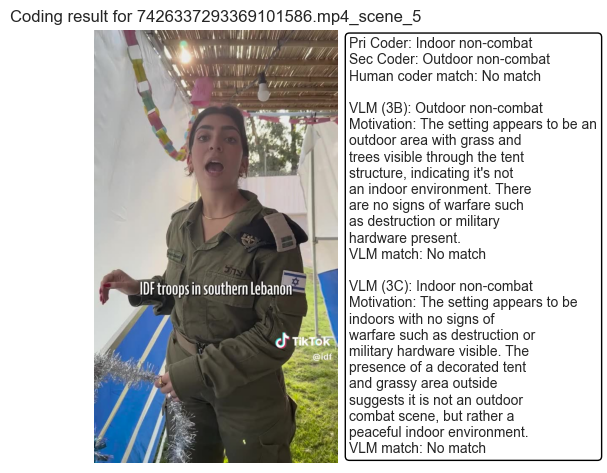

...

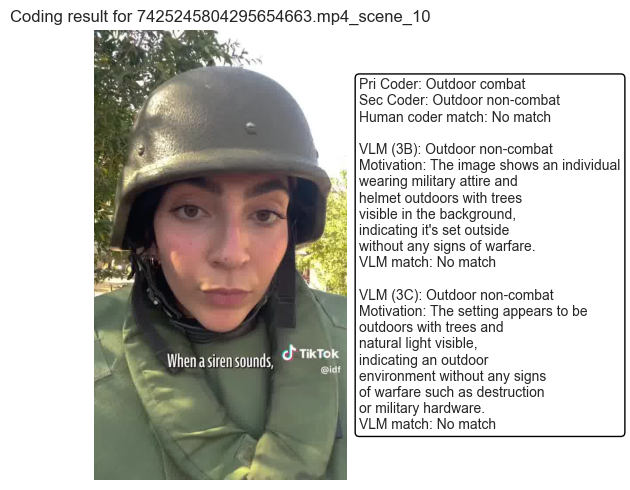

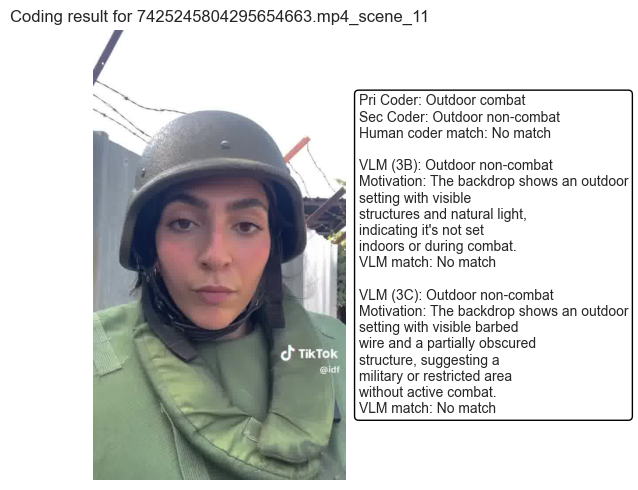

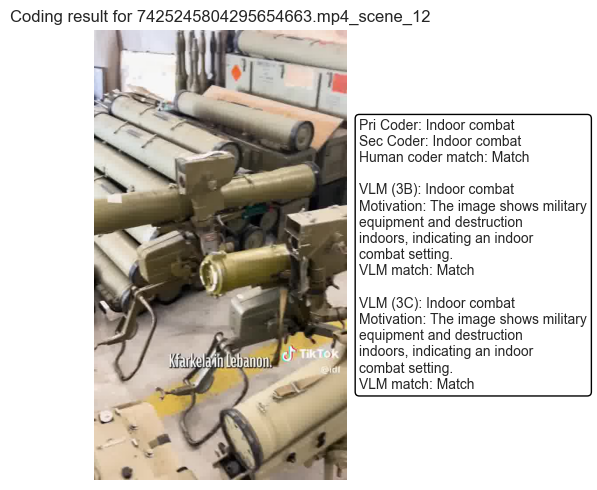

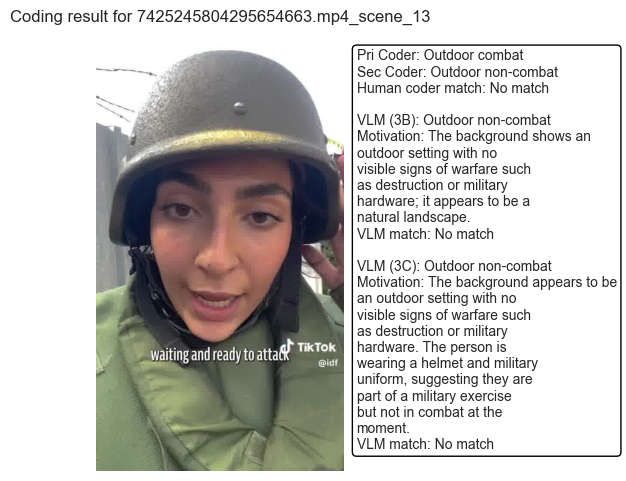

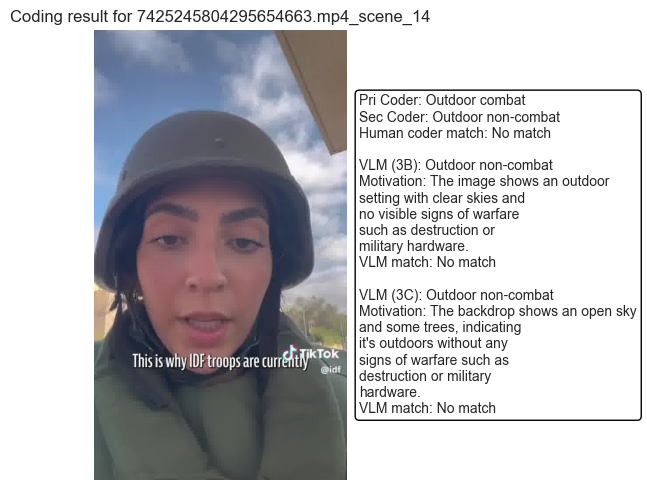

In [59]:
import textwrap
# Visualize each prediction (setting)
for index, scene in df_coding.iterrows():
    video_id = scene['url']
    scene_id = scene['id']

    cleaned_id = re.sub(r'\.mp4', '', scene_id)
    image_path = os.path.join(frames_folder, str(video_id), f'{cleaned_id}.jpeg')
    image = face_recognition.load_image_file(image_path) # load image

    plt.figure(figsize=(10, 5))
    plt.title(f"Coding result for {scene_id}", fontsize=12)
    plt.axis('off')
    plt.imshow(image)

    # Set up textwrap
    max_width = 30

    setting_m = scene['setting_m']
    setting_c = scene['setting_c']
    setting_vlm_3b = scene['setting_vlm_3b']
    setting_vlm_3b_motivate = scene['setting_vlm_3b_motivation']
    wrapped_motivation_3b = textwrap.fill(setting_vlm_3b_motivate, width=max_width)

    setting_vlm_3c = scene['setting_vlm_3c']
    setting_vlm_3c_motivate = scene['setting_vlm_3c_motivation']
    wrapped_motivation_3c = textwrap.fill(setting_vlm_3c_motivate, width=max_width)




    if setting_m == setting_c:
        human_match = 'Match'
    else:
        human_match = 'No match'

    if setting_c == setting_vlm_3b and setting_m == setting_vlm_3b:
        vlm_match_3b = 'Match'
    else:
        vlm_match_3b = 'No match'

    if setting_c == setting_vlm_3c and setting_m == setting_vlm_3c:
        vlm_match_3c = 'Match'
    else:
        vlm_match_3c = 'No match'


    annotation = f'Pri Coder: {setting_m} \nSec Coder: {setting_c}\n' \
    f'Human coder match: {human_match}\n\n' \
    f'VLM (3B): {setting_vlm_3b}\nMotivation: {wrapped_motivation_3b}\n' \
    f'VLM match: {vlm_match_3b}\n\n' \
    f'VLM (3C): {setting_vlm_3c}\nMotivation: {wrapped_motivation_3c}\n' \
    f'VLM match: {vlm_match_3c}' \
    # Annotate on the middle-right side of the image
    plt.annotate(
        annotation,
        xy=(1.05, 0.5),  # Position: 1.05 means slightly to the right of the axes
        xycoords='axes fraction',  # Position relative to axes (not data coordinates)
        fontsize=10,
        ha='left',  # Align text to the left
        va='center',  # Vertically centered
        bbox=dict(boxstyle='round,pad=0.3', edgecolor='black', facecolor='white')  # Add highlight box
    )
    # Adjust spacing
    plt.grid(False)
    plt.tight_layout()
    plt.savefig(f'/Users/mikechow.sg/Documents/03a UvA/03_Thesis/idf_spokespersonship/coding_sample/01a_test_sample_1/coding_results_setting/{scene_id}_coding_result.jpeg')
    plt.show()




# Reprocessing and splitting setting
We realized that the combined dimensions were likely depressing the agreement results. Thus, we decided to split them.

In [77]:
df_coding = pd.read_csv('/Users/mikechow.sg/Documents/03a UvA/03_Thesis/idf_spokespersonship/coding_sample/01a_test_sample_1/test_sample_scenes_1_merged.csv')

In [76]:
def split_setting(setting_str):

    combat_presence = ''
    location = ''
    if setting_str == 'Graphics':
        location = 'Graphics'
        combat_presence = 'Graphics'
    elif setting_str == 'Uncertain':
        location = 'Uncertain'
        combat_presence = 'Uncertain'
    else:
        if 'Outdoor' in setting_str:
            location = 'Outdoor'
        elif 'Indoor' in setting_str:
            location = 'Indoor'
        if 'non-combat' in setting_str:
            combat_presence = 'Non-combat'
        elif 'combat' in setting_str and 'non-combat' not in setting_str:
            combat_presence = 'Combat'

    # Error checking
    if combat_presence == '' or location == '':
        print(f"Error: Setting {setting_str} is not recognized.")

    return location, combat_presence





In [78]:
df_coding['location_vlm_3c'], df_coding['combat_presence_vlm_3c'] = zip(*df_coding['setting_vlm_3c'].apply(split_setting))

df_coding['location_vlm_3b'], df_coding['combat_presence_vlm_3b'] = zip(*df_coding['setting_vlm_3b'].apply(split_setting))
df_coding['location_vlm_3a'], df_coding['combat_presence_vlm_3a'] = zip(*df_coding['setting_vlm_3a'].apply(split_setting))
df_coding['location_m'], df_coding['combat_presence_m'] = zip(*df_coding['setting_m'].apply(split_setting))
df_coding['location_c'], df_coding['combat_presence_c'] = zip(*df_coding['setting_c'].apply(split_setting))


In [79]:
df_coding



,id,url,from_dataset,start_frame,start_time,start_fps,end_frame,end_time,end_fps,scene_num,...,location_vlm_3c,combat_presence_vlm_3c,location_vlm_3b,combat_presence_vlm_3b,location_vlm_3a,combat_presence_vlm_3a,location_m,combat_presence_m,location_c,combat_presence_c
0,7426337293369101586.mp4_scene_1,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,0,00:00:00.000,23.976,114,00:00:04.755,23.976,1,...,Outdoor,Non-combat,Outdoor,Non-combat,Outdoor,Non-combat,Outdoor,Non-combat,Outdoor,Non-combat
1,7426337293369101586.mp4_scene_2,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,114,00:00:04.755,23.976,316,00:00:13.180,23.976,2,...,Indoor,Non-combat,Indoor,Non-combat,Indoor,Non-combat,Indoor,Non-combat,Outdoor,Non-combat
2,7426337293369101586.mp4_scene_3,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,316,00:00:13.180,23.976,501,00:00:20.896,23.976,3,...,Outdoor,Non-combat,Outdoor,Non-combat,Outdoor,Non-combat,Indoor,Non-combat,Outdoor,Non-combat
3,7426337293369101586.mp4_scene_4,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,501,00:00:20.896,23.976,669,00:00:27.903,23.976,4,...,Indoor,Non-combat,Indoor,Non-combat,Indoor,Non-combat,Indoor,Non-combat,Outdoor,Non-combat
4,7426337293369101586.mp4_scene_5,7426337293369101586,dd01ff7a2a7ed42db656b1c7dbede342,669,00:00:27.903,23.976,887,00:00:36.995,23.976,5,...,Indoor,Non-combat,Outdoor,Non-combat,Outdoor,Non-combat,Indoor,Non-combat,Outdoor,Non-combat
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
90,7425245804295654663.mp4_scene_10,7425245804295654663,dd01ff7a2a7ed42db656b1c7dbede342,1926,00:01:04.200,30.000,2137,00:01:11.233,30.000,10,...,Outdoor,Non-combat,Outdoor,Non-combat,Outdoor,Non-combat,Outdoor,Combat,Outdoor,Non-combat
91,7425245804295654663.mp4_scene_11,7425245804295654663,dd01ff7a2a7ed42db656b1c7dbede342,2137,00:01:11.233,30.000,2290,00:01:16.333,30.000,11,...,Outdoor,Non-combat,Outdoor,Non-combat,Outdoor,Non-combat,Outdoor,Combat,Outdoor,Non-combat
92,7425245804295654663.mp4_scene_12,7425245804295654663,dd01ff7a2a7ed42db656b1c7dbede342,2290,00:01:16.333,30.000,2475,00:01:22.500,30.000,12,...,Indoor,Combat,Indoor,Combat,Indoor,Combat,Indoor,Combat,Indoor,Combat
93,7425245804295654663.mp4_scene_13,7425245804295654663,dd01ff7a2a7ed42db656b1c7dbede342,2475,00:01:22.500,30.000,2561,00:01:25.367,30.000,13,...,Outdoor,Non-combat,Outdoor,Non-combat,Outdoor,Non-combat,Outdoor,Combat,Outdoor,Non-combat


In [81]:
# update
df_coding.to_csv('/Users/mikechow.sg/Documents/03a UvA/03_Thesis/idf_spokespersonship/coding_sample/01a_test_sample_1/test_sample_scenes_1_merged.csv')

In [82]:
# Establish new refactor

location_refactor = {'Graphics' : 1,
                    'Indoor': 2,
                    'Outdoor': 3,
                    'Uncertain': np.nan}

combat_presence_refactor = {'Graphics' : 1,
                    'Combat': 2,
                    'Non-combat': 3,
                    'Uncertain': np.nan}

In [85]:
# Check Calculate new intercoder agreement

# Define the columns to be compared
df_intercoder_location_combat_presence = pd.DataFrame([

    {'column_1':'location_m','column_2':'location_c','type':'location'},
    {'column_1':'location_m','column_2':'location_vlm_3a','type':'location'},
    {'column_1':'location_c','column_2':'location_vlm_3a','type':'location'},
    {'column_1':'location_m','column_2':'location_vlm_3b','type':'location'},
    {'column_1':'location_c','column_2':'location_vlm_3b','type':'location'},
    {'column_1':'location_m','column_2':'location_vlm_3c','type':'location'},
    {'column_1':'location_c','column_2':'location_vlm_3c','type':'location'},
    {'column_1':'location_vlm_3a','column_2':'location_vlm_3b','type':'location'},
    {'column_1':'location_vlm_3a','column_2':'location_vlm_3c','type':'location'},
    {'column_1':'location_vlm_3b','column_2':'location_vlm_3c','type':'location'},

    {'column_1':'combat_presence_m','column_2':'combat_presence_c','type':'combat_presence'},
    {'column_1':'combat_presence_m','column_2':'combat_presence_vlm_3a','type':'combat_presence'},
    {'column_1':'combat_presence_c','column_2':'combat_presence_vlm_3a','type':'combat_presence'},
    {'column_1':'combat_presence_m','column_2':'combat_presence_vlm_3b','type':'combat_presence'},
    {'column_1':'combat_presence_c','column_2':'combat_presence_vlm_3b','type':'combat_presence'},
    {'column_1':'combat_presence_m','column_2':'combat_presence_vlm_3c','type':'combat_presence'},
    {'column_1':'combat_presence_c','column_2':'combat_presence_vlm_3c','type':'combat_presence'},
    {'column_1':'combat_presence_vlm_3a','column_2':'combat_presence_vlm_3b','type':'combat_presence'},
    {'column_1':'combat_presence_vlm_3a','column_2':'combat_presence_vlm_3c','type':'combat_presence'},
    {'column_1':'combat_presence_vlm_3b','column_2':'combat_presence_vlm_3c','type':'combat_presence'},


])


In [86]:
# Calculate reliability
for i, row in df_intercoder_location_combat_presence.iterrows():
    column_1 = row['column_1']
    column_2 = row['column_2']
    coding_type = row['type']
    # if coding_type == 'setting':
    #     refactor_dict = setting_refactor
    #
    if coding_type == 'location':
        refactor_dict = location_refactor
    elif coding_type == 'combat_presence':
        refactor_dict = combat_presence_refactor

    df_intercoder = df_coding[[column_1, column_2]].copy()
    df_intercoder[column_1] =  df_intercoder[column_1].map(refactor_dict)
    df_intercoder[column_2] =  df_intercoder[column_2].map(refactor_dict)


    df_intercoder = df_intercoder.replace(-1, np.nan)

    # print(df_intercoder)

    df_intercoder_location_combat_presence.loc[i, 'intercoder_alpha'] = calc_alpha(df_intercoder[[column_1, column_2]])

In [87]:
df_intercoder_location_combat_presence

,column_1,column_2,type,intercoder_alpha
0,location_m,location_c,location,0.804505
1,location_m,location_vlm_3a,location,0.893593
2,location_c,location_vlm_3a,location,0.825485
3,location_m,location_vlm_3b,location,0.895186
4,location_c,location_vlm_3b,location,0.827614
5,location_m,location_vlm_3c,location,0.853399
6,location_c,location_vlm_3c,location,0.828657
7,location_vlm_3a,location_vlm_3b,location,0.936909
8,location_vlm_3a,location_vlm_3c,location,0.873947
9,location_vlm_3b,location_vlm_3c,location,0.896284


As suspected, combat presence was specifically the culprit of deflating the agreement scores. In fact, the VLM's agreement with myself and the secondary coder separately was higher than myself with the secondary coder! This thus allows us to focus on combat presence as a problem point.

In [88]:
# Filter and visualize as networks again
df_intercoder_location = df_intercoder_location_combat_presence.loc[[0,3,4]]
df_intercoder_location

,column_1,column_2,type,intercoder_alpha
0,location_m,location_c,location,0.804505
3,location_m,location_vlm_3b,location,0.895186
4,location_c,location_vlm_3b,location,0.827614


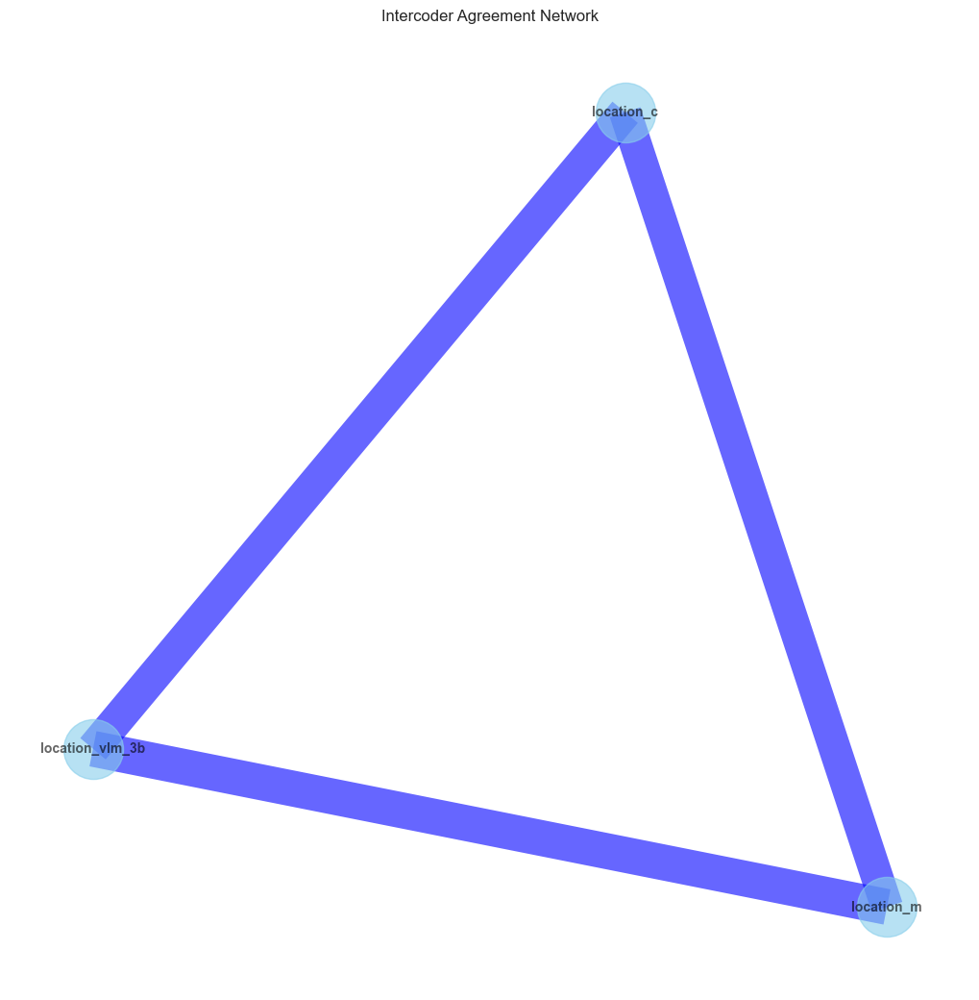

In [90]:
viz_agreement_network(df_intercoder_location, '/Users/mikechow.sg/Documents/03a UvA/03_Thesis/idf_spokespersonship/coding_sample/01a_test_sample_1/location_agreement_network.svg')

In [89]:
df_intercoder_combat_presence = df_intercoder_location_combat_presence.loc[[10,13,14]]
df_intercoder_combat_presence

,column_1,column_2,type,intercoder_alpha
10,combat_presence_m,combat_presence_c,combat_presence,0.777542
13,combat_presence_m,combat_presence_vlm_3b,combat_presence,0.443086
14,combat_presence_c,combat_presence_vlm_3b,combat_presence,0.650875


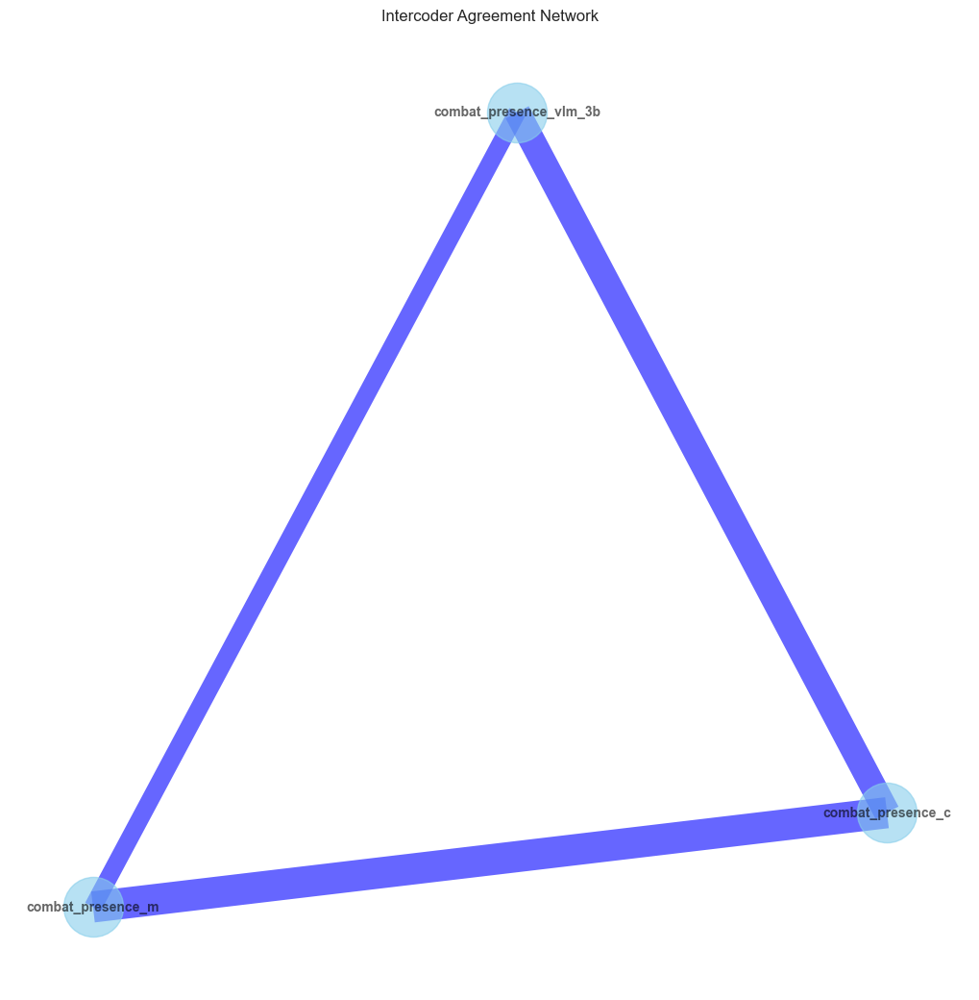

In [92]:
viz_agreement_network(df_intercoder_combat_presence, '/Users/mikechow.sg/Documents/03a UvA/03_Thesis/idf_spokespersonship/coding_sample/01a_test_sample_1/combat_presence_agreement_network.svg')